In [1]:
import glob
from PIL import Image
from transformers import AutoProcessor, BlipForConditionalGeneration
from bs4 import BeautifulSoup
from io import BytesIO
from IPython.display import display

c:\Users\Zenbook\Documents\Learning\Coursera\GenAI-powered-application\my_env\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
processor = AutoProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


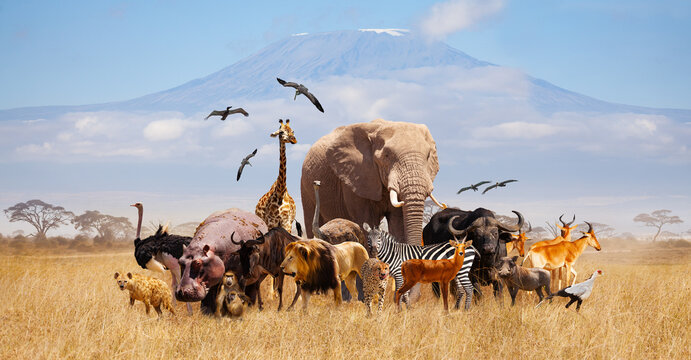

`cache.key_cache[idx]` is deprecated and will be removed in v4.56.0. Use `cache.layers[idx].keys` instead.
`cache.value_cache[idx]` is deprecated and will be removed in v4.56.0. Use `cache.layers[idx].values` instead.


Image: C:\Users\Zenbook\Downloads\images\360_F_415790935_7va5lMHOmyhvAcdskXbSx7lDJUp0cfja.jpg
Caption: the image of a herd of animals



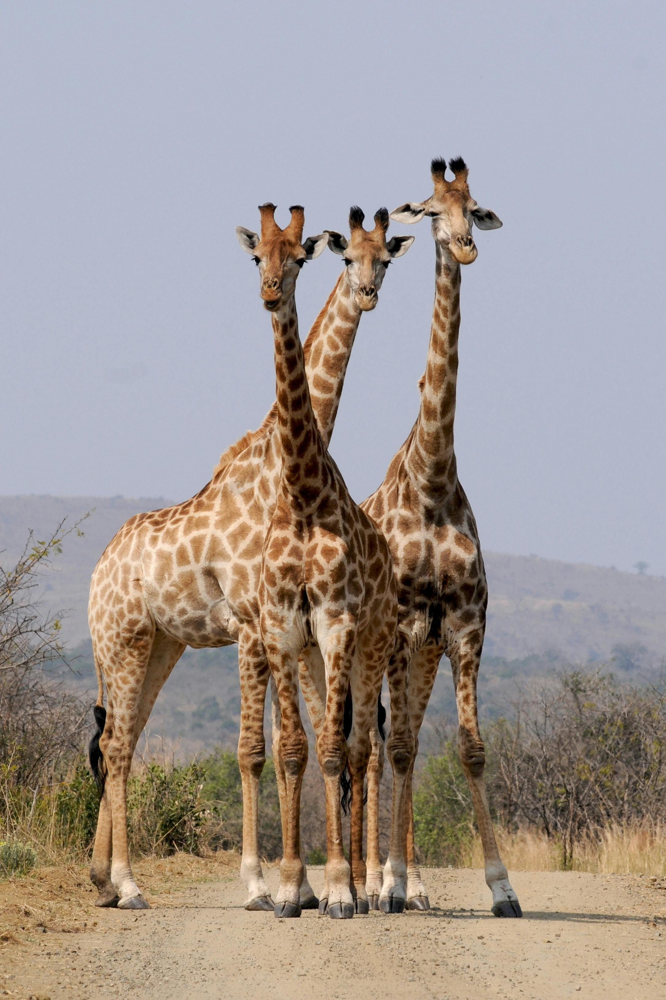

Image: C:\Users\Zenbook\Downloads\images\pexels-pixabay-34098.jpg
Caption: the image of two gis is very clear



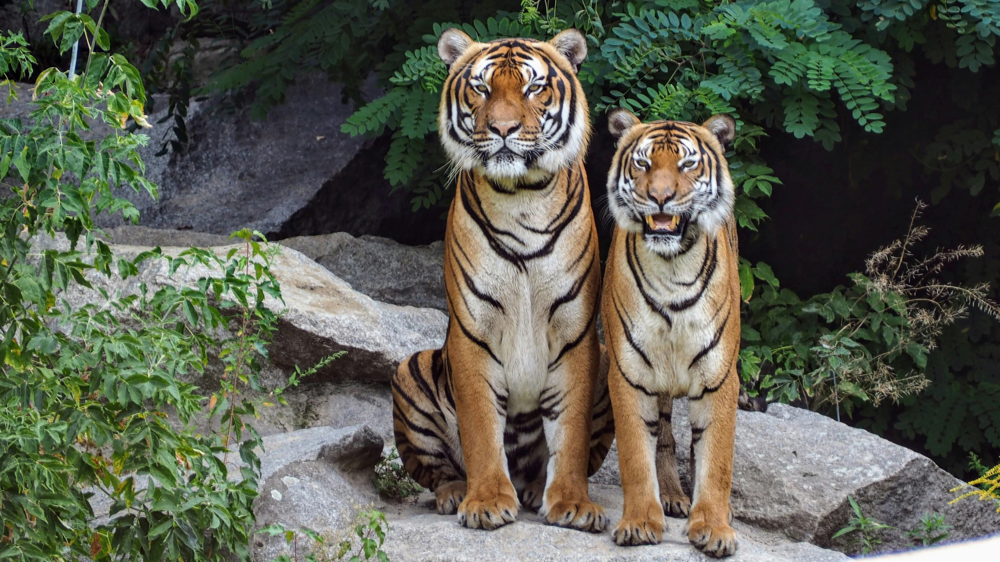

Image: C:\Users\Zenbook\Downloads\images\pexels-thomas-b-270703-814898.jpg
Caption: the image of two tigers



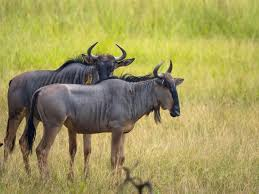

Image: C:\Users\Zenbook\Downloads\images\images.jpeg
Caption: the image of two animals



In [ ]:
image_dir = input("Enter the directory containing images: ")
if not image_dir:
    image_dir = "images"  # Default directory if none provided
image_extensions = ["*.jpg", "*.jpeg", "*.png", "*.gif"]

with open("captions.txt", "w", encoding="utf-8") as caption_file:
    for ext in image_extensions:
        for image_path in glob.glob(f"{image_dir}/{ext}"):
            # Load the image
            image = Image.open(image_path).convert("RGB")
            
            # Display the image
            display(image)
            
            # Preprocess the image and prepare the text input
            text = "the image of"
            inputs = processor(images=image, text=text, return_tensors="pt")
            
            # Generate caption
            output = model.generate(**inputs, max_length=50)
            
            # Decode the output to get the caption
            caption = processor.decode(output[0], skip_special_tokens=True)
            
            # Write caption to file and print to console
            caption_file.write(f"Image: {image_path}\nCaption: {caption}\n\n")
            print(f"Image: {image_path}")
            print(f"Caption: {caption}\n")